In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
%set_env TRAINING="True"
import torch
import sys, os
import pystk
import ray
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print('device = ', device)
ray.init(logging_level=50)
import sys
sys.path.append("../")

env: TRAINING="True"
device =  cpu


In [2]:
ray.shutdown()

In [3]:
from state_agent.actors import SteeringActor, DriftActor, SpeedActor
from state_agent.planners import PlayerPuckGoalPlannerActor, PlayerPuckGoalFineTunedPlannerActor, PlayerPuckGoalPlannerActorNetwork, PlayerPuckGoalFineTunedPlannerActorNetwork
from state_agent.agents import Agent, BaseTeam, Action, ComposedAgent, ComposedAgentNetwork
from state_agent.utils_agent import Rollout, run_soccer_agent, rollout_many, show_trajectory_histogram, Match
from state_agent.core_utils import load_model, save_model
from state_agent.rewards import SoccerBallDistanceObjective
from state_agent.features import get_distance_cart_to_puck, SoccerFeatures
from state_agent.train_policy_gradient import reinforce, SoccerReinforcementConfiguration

import numpy as np
import copy
import matplotlib.pyplot as plt

WARNING! Submission grader is using a different torch version than locally installed! Use 1.9.x


In [ ]:
data = run_soccer_agent(Agent(SteeringActor(), train=True))

In [4]:
def get_initializations(actor_class):    
    distance_objective = SoccerBallDistanceObjective(150)
    many_actors = [actor_class() for i in range(100)]

    data = rollout_many([
        Agent(actor, accel=0.05) for actor in many_actors
    ], randomize=True, n_steps=600)

    good_initialization = many_actors[ np.argmax([distance_objective.calculate_state_score(d[-1]) for d in data]) ]
    bad_initialization = many_actors[ np.argmin([distance_objective.calculate_state_score(d[-1]) for d in data]) ]
    
    return good_initialization, bad_initialization



In [ ]:
#good_initialization = best_steering_net
good_initialization, _ = get_initializations(SteeringActor)

actor_net = copy.deepcopy(good_initialization.actor_net)
actors = [SteeringActor(actor_net)]

def gen_agent(*args, **kwargs):
    return Agent(*args, accel=0.05, target_speed=10.0, **kwargs)

# configuration
config = SoccerReinforcementConfiguration()
config.agent = gen_agent

# iterations is high relatively here to help force a good outcome from a bad initialization
best_steering_net2 = reinforce(actors[0], actors, config, 
                              n_epochs=5, n_iterations=500, n_trajectories=200, n_validations=100, T=1
                    )

In [ ]:
data = run_soccer_agent(
    Agent(
        SteeringActor(best_steering_net2), accel=0.1), 
        randomize=True, ball_location=[-6., -60.], player_location=[-20, 0, -50]
    )

In [ ]:
# save the steering actor
SteeringActor(best_steering_net).save_model()

In [5]:
# Load the Steering Actor
best_steering_net = SteeringActor().load_model()

In [ ]:
# train the speed actor
good_initialization_speed, _ = get_initializations(SpeedActor)

actor_net = copy.deepcopy(good_initialization_speed.actor_net)
actors = [SteeringActor(best_steering_net, train=False), SpeedActor(actor_net)]

def gen_agent(*args, **kwargs):
    reverse = np.random.uniform(0, 1) < 0.25
    speed = np.random.uniform(0, 23) * (-1.0 if reverse else 1.0)
    return Agent(*args, target_speed=speed, **kwargs)

# configuration
config = SoccerReinforcementConfiguration()
config.agent = gen_agent

# iterations is high relatively here to help force a good outcome from a bad initialization
best_speed_net = reinforce(actors[1], actors, config, 
                              n_epochs=5, n_iterations=50, n_trajectories=200, n_validations=100, T=1
                    )
best_speed_net2 = actor_net

In [ ]:
data = run_soccer_agent(
    Agent(
        SteeringActor(best_steering_net), 
        SpeedActor(best_speed_net2), 
        target_speed=-4.5), 
    randomize=True)

In [ ]:
# Save best_speed_net
SpeedActor(best_speed_net).save_model()

In [6]:
# Load the Speed Actor
best_speed_net = SpeedActor().load_model()

In [ ]:
# train the drift actor
#good_initialization_drift, _ = get_initializations(DriftActor)

#action_net = copy.deepcopy(good_initialization_drift.action_net)
actors = [SteeringActor(best_steering_net, train=False), DriftActor(action_net), SpeedActor(best_speed_net, train=False)]

def gen_agent(*args, **kwargs):
    speed = np.random.uniform(0, 23)
    return Agent(*args, target_speed=speed, **kwargs)

# configuration
config = SoccerReinforcementConfiguration()
config.agent = gen_agent

best_drift_net = reinforce(actors[1], actors, config, 
                              n_epochs=5, n_iterations=200, n_trajectories=1000, n_validations=100, T=2
                    )
best_drift_net = action_net

In [ ]:
# save the drift actor
DriftActor(best_drift_net).save_model()

In [7]:
# load the drift actor
best_drift_net=DriftActor().load_model()

In [ ]:
data = run_soccer_agent(Agent( 
    SteeringActor(best_steering_net),
    DriftActor(best_drift_net),
    SpeedActor(best_speed_net),        
    target_speed=21.0
), randomize=True)

In [7]:
# train the player goal scoring planner
from state_agent.utils_agent import euler_to_quaternion

def create_planner_actor():
    return PlayerPuckGoalPlannerActor()

def gen_agent(*args, **kwargs):
    return Agent(*args, target_speed=np.random.uniform(0, 23), **kwargs)

def rollout_initializer(world_info, randomize, **kwargs):
        
    #wall_case = np.random.uniform(low=0.0, high=1.0) < 1.0
    wall_case = True
    
    #behind_case = np.random.uniform(low=0.0, high=1.0) < 0.5
    behind_case = False
    
    # generate a rollout where the player and puck are near each other
    position = [
        np.random.uniform(low=-35, high=35),
        np.random.uniform(low=-50, high=62), # trying to force the puck to a 90 degree angle at worst (near the wall)
    ]
    
    offset = [np.random.uniform(low=-1.0, high=1.0), -6]    
    
    position = [
            np.random.uniform(low=-35, high=35),
            np.random.uniform(low=-20, high=20)
        ]
    # put the cart facing away from the puck
    offset = [np.random.uniform(low=-1.0, high=1.0), np.random.uniform(low=1.0, high=15.0)]        
        
    orientation = (0, 0, 0)
        
    player_location = [position[0] + offset[0], 1, position[1] + offset[1]]
        
    if behind_case:
        
        angle = np.random.uniform(low=0.35, high=1.0) * np.sign(np.random.uniform(0, 1))
        
        # point the cart away from the puck
        orientation = euler_to_quaternion((0, angle, 0))
        
    elif wall_case:
        angle = np.random.uniform(0, 2 * np.pi)
        
        # determine x and y based on length        
        y = np.cos(angle) * 50
        x = np.sin(angle) * 50
        player_location = [x, 1, y]                
        orientation = euler_to_quaternion((0, angle, 0))
        #player_location = None
        #position = [45 * side, -40]
            
    world_info.set_ball_location((position[0], 1, position[1]), (0, 0, 0))        
    if player_location is not None:
        world_info.set_kart_location(0, player_location, orientation, 0)
        
def post_epoch(actor, context):
    # show a histogram of distances
    show_trajectory_histogram(context.trajectories, get_distance_cart_to_puck, max=60, bins=20)
    plt.hist(context.rewards) 
    plt.title("Rewards")
    plt.show()
    plt.hist(context.actions, 4, range=(0, 3)) 
    plt.title("Actions")
    plt.show()
    print(np.sum(np.argmax(context.actions, axis=1) == 0), np.sum(np.argmax(context.actions, axis=1) == 1), np.sum(np.argmax(context.actions, axis=1) == 2), np.sum(np.argmax(context.actions, axis=1) == 3))

good_initialization_planner, _ = get_initializations(create_planner_actor)

good_initialization_planner = PlayerPuckGoalPlannerActor()

# Going to need to train this a few times as the convergence is slow!!! Comment this line to retrain 
actor_net = copy.deepcopy(good_initialization_planner.actor_net)

# copy the best classifiers over
#actor_net.classifiers[0] = best_planner_net.classifiers[0]
#actor_net.classifiers[1] = best_planner_net.classifiers[1]

actors = [PlayerPuckGoalPlannerActor(actor_net), SpeedActor(best_speed_net, train=False), SteeringActor(best_steering_net, train=False)]

# give it a positive random weight to make it the worst case
#action_net.net[0].weight = torch.nn.Parameter(torch.Tensor([[np.random.uniform(0, 1.0)]]))

#starting_weight = action_net.net[0].weight.clone()
#print("Starting weight", action_net.net[0].weight)

# configuration
config = SoccerReinforcementConfiguration()
config.agent = gen_agent
config.rollout_initializer = rollout_initializer

# iterations is high relatively here to help force a good outcome from a bad initialization
best_planner_net = reinforce(actors[0], actors, config, 
                              n_epochs=10, n_iterations=200, n_trajectories=50, n_validations=20, T=1,
                              epoch_post_process=post_epoch
                    )
best_planner_net = actor_net

#assert(action_net.net[0].weight != starting_weight)


(pid=32815) WARNING! Submission grader is using a different torch version than locally installed! Use 1.9.x


KeyboardInterrupt: 

In [43]:
# case 1 against a wall
extractor=SoccerFeatures(None, [0, 0, 0])
action_net = best_planner_net
action_net.train()

#assert(torch.argmax(action_net(None, torch.Tensor([10.255, 0.9, 0.0, 0.0, 1.0, 1.0, 1.0, 2.0, 2.0, 2.0, 3.0, 3.0, 3.0]), extractor)) == 2)
# case 2, travelling to puck
#assert(torch.argmax(action_net(None, torch.Tensor([10.255, 10.255, 10.01, 10.01, 1.0, 1.0, 1.0, 2.0, 2.0, 2.0, 3.0, 3.0, 3.0]), extractor)) == 2)
# case 3, moving puck
#assert(action_net(torch.Tensor([-1.03, -0.24, 2.0, -0.01, 1.0, 1.0, 1.0, 2.0, 2.0, 2.0, 3.0, 3.0, 3.0]))[0] == 2)

output = action_net(None,torch.Tensor([-0.055, -0.01, 0.12, 0.12, -0.35, 1.0, 1.0, 1.0, 2.0, 2.0, 2.0, 3.0, 3.0, 3.0]), extractor)
output1 = action_net(None,torch.Tensor([-0.055, -0.1, 0.13, 0.12, 0.4, 1.0, 1.0, 1.0, 2.0, 2.0, 2.0, 3.0, 3.0, 3.0]), extractor)
output2 = action_net(None,torch.Tensor([10.255, 0.9, 0.2, 0.4, -0.2, 1.0, 1.0, 1.0, 2.0, 2.0, 2.0, 3.0, 3.0, 3.0]), extractor)
output3 = action_net(None,torch.Tensor([10.255, 0.9, 0.1, 0.1, 0.2, 1.0, 1.0, 1.0, 2.0, 2.0, 2.0, 3.0, 3.0, 3.0]), extractor)

output4 = action_net(None,torch.Tensor([10.255, 0.9, 2.0, 10.1, 10.01, 1.0, 1.0, 1.0, 2.0, 2.0, 2.0, 3.0, 3.0, 3.0]), extractor)
output5 = action_net(None,torch.Tensor([-0.01, -0.01, 2.0, 12.1, 0.01,  1.0, 1.0, 1.0, 2.0, 2.0, 2.0, 3.0, 3.0, 3.0]), extractor)
action_net.eval()
print(output)
print(output1)
print(output2)
print(output3)
print(output4)
print(output5)




tensor([0.8853, 0.3894, 0.9724], grad_fn=<CatBackward0>)
tensor([0.9098, 0.3806, 0.9388], grad_fn=<CatBackward0>)
tensor([0.0340, 0.3226, 0.9824], grad_fn=<CatBackward0>)
tensor([0.0340, 0.4072, 0.9473], grad_fn=<CatBackward0>)
tensor([0.0340, 0.0373, 0.9981], grad_fn=<CatBackward0>)
tensor([0.8861, 0.0373, 0.9832], grad_fn=<CatBackward0>)


IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (400, 300) to (400, 304) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


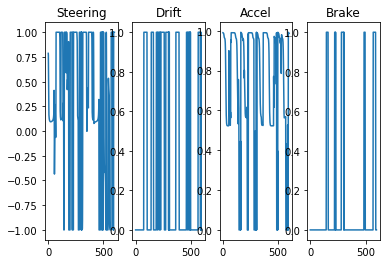

In [11]:
from state_agent.utils_agent import euler_to_quaternion

orientation = euler_to_quaternion((0, -0.9, 0))

viz_rollout_soccer = { "screen_width": 400, "screen_height": 300, "mode": "soccer", "players":[(0, False, "konqi")], "num_karts":2 }
data = run_soccer_agent(Agent( 
    PlayerPuckGoalPlannerActor(        
        actor_net=best_planner_net     
    ), 
    SteeringActor(best_steering_net),
    SpeedActor(best_speed_net),            
    DriftActor(best_drift_net),
    accel=0.1, target_speed=20.0
), randomize=True, player_location=[0, 1, -60], player_orientation=orientation, rollout=viz_rollout_soccer)

In [18]:
# Save the Planner Actor
PlayerPuckGoalPlannerActor(best_planner_net).save_model()

PlayerPuckGoalPlannerActorNetwork(
  (action_net): Selection()
  (classifiers): ModuleList(
    (0): ClassifierNetwork(
      (action_net): LinearWithTanh(
        (linear): LinearNetwork(
          (base): BaseNetwork(
            (net): Sequential(
              (0): Linear(in_features=2, out_features=5, bias=True)
              (1): Tanh()
              (2): Linear(in_features=5, out_features=1, bias=True)
              (3): Tanh()
            )
          )
        )
      )
    )
    (1): ClassifierNetwork(
      (action_net): LinearWithTanh(
        (linear): LinearNetwork(
          (base): BaseNetwork(
            (net): Sequential(
              (0): Linear(in_features=1, out_features=1, bias=False)
              (1): Tanh()
              (2): Linear(in_features=1, out_features=1, bias=False)
              (3): Tanh()
            )
          )
        )
      )
    )
    (2): ClassifierNetwork(
      (action_net): LinearWithTanh(
        (linear): LinearNetwork(
          (base

In [8]:
# load the planner actor
best_planner_net=PlayerPuckGoalPlannerActor().load_model()

reverse_classifier=best_planner_net.classifiers[2]
save_model(reverse_classifier, "reverse_classifier")

Performing trajectory rollouts: 50
[Parameter containing:
tensor([[ 1.9549e-01,  1.3070e-01,  1.6843e-01,  4.7276e-02,  1.9864e-01,
          1.5770e-01,  3.2084e-01,  3.4290e-02,  4.1942e-02,  2.3789e-01,
         -2.8843e-02],
        [-7.3783e-02, -2.1142e-01,  1.2030e-01,  1.9650e-01, -1.7947e-01,
         -1.9842e-01,  1.5716e-01,  2.9275e-01,  2.9943e-01,  2.4806e-01,
         -2.0212e-01],
        [ 1.6215e-01, -1.9208e-01,  1.3670e-01,  1.9871e-01, -1.4877e-01,
         -1.3882e-01,  2.8876e-01, -5.2575e-02, -2.3066e-01,  6.4237e-03,
         -5.9614e-02],
        [ 2.2518e-01,  9.7502e-02, -1.3478e-01,  2.0104e-01, -7.3729e-02,
          1.6354e-01,  1.9518e-02, -1.9336e-01, -6.5642e-02, -1.9177e-01,
         -2.5712e-01],
        [ 1.5831e-01, -2.2282e-01, -1.0429e-01, -3.0594e-02,  7.7357e-02,
         -2.2593e-01, -1.6315e-01, -4.1048e-02, -1.9095e-02,  2.3788e-01,
          2.5173e-01],
        [ 1.5518e-01,  2.6423e-01,  7.4859e-02, -1.3473e-01,  4.9327e-02,
         -1.8

tensor([[-0.9970, -0.9970],
        [ 1.0000,  1.0000],
        [-0.9898, -0.9898],
        ...,
        [-0.8060, -0.8060],
        [-0.8048, -0.8048],
        [-0.8048, -0.8048]])
Updating gradient...
epoch = 0 dist = (93.03646494241866, 103.65152340577198, 98.94143660114362), best_dist = None 


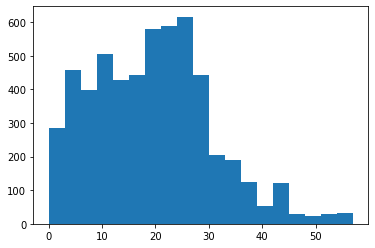

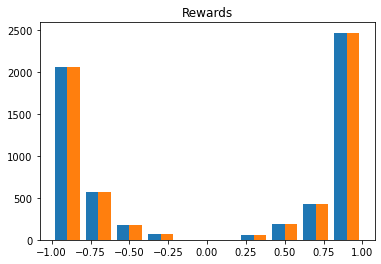

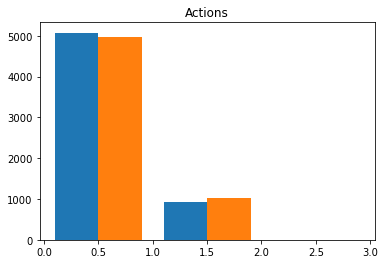

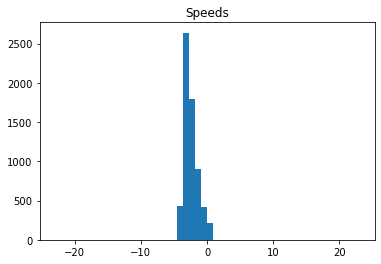

5820 180 0
Performing trajectory rollouts: 50
[Parameter containing:
tensor([[ 2.0267e-01,  1.2188e-01,  1.6702e-01,  5.0728e-02,  1.9931e-01,
          1.6110e-01,  3.2523e-01,  3.2355e-02,  4.1942e-02,  2.4286e-01,
         -2.4440e-02],
        [-6.3284e-02, -2.0014e-01,  1.2957e-01,  2.1086e-01, -1.7011e-01,
         -1.8305e-01,  1.7086e-01,  2.9499e-01,  2.9943e-01,  2.6813e-01,
         -1.8692e-01],
        [ 1.3314e-01, -2.2894e-01,  9.7141e-02,  1.6235e-01, -1.4462e-01,
         -1.7302e-01,  2.4884e-01, -5.7696e-02, -2.3066e-01,  6.3592e-03,
         -9.2585e-02],
        [ 2.2633e-01,  1.0369e-01, -1.2909e-01,  2.1133e-01, -8.7710e-02,
          1.6829e-01,  2.7762e-02, -1.8604e-01, -6.5642e-02, -1.8115e-01,
         -2.5148e-01],
        [ 1.7023e-01, -2.0908e-01, -8.1093e-02, -5.5360e-03,  8.0737e-02,
         -2.0138e-01, -1.3663e-01, -4.2991e-02, -1.9095e-02,  2.2270e-01,
          2.7488e-01],
        [ 1.4061e-01,  2.6181e-01,  7.5073e-02, -1.3666e-01,  4.1498e-02,
  

tensor([[ 0.7705,  0.7705],
        [ 0.7706,  0.7706],
        [ 0.7707,  0.7707],
        ...,
        [ 0.8961,  0.8961],
        [ 0.9751,  0.9751],
        [-0.9751, -0.9751]])
Updating gradient...
epoch = 1 dist = (88.59493613334797, 108.20326997866995, 100.79091950792531), best_dist = (93.03646494241866, 103.65152340577198, 98.94143660114362) 


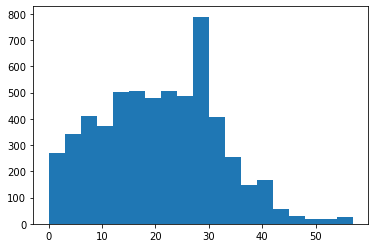

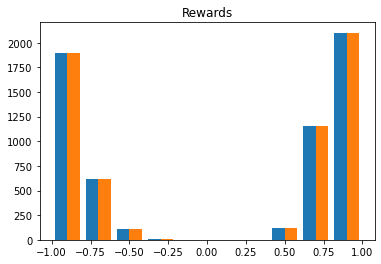

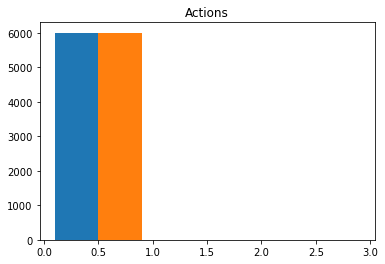

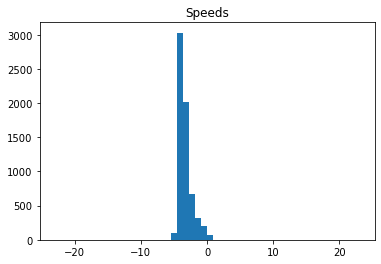

6000 0 0
Performing trajectory rollouts: 50
[Parameter containing:
tensor([[ 0.2038,  0.1156,  0.1797,  0.0569,  0.1974,  0.1675,  0.3237,  0.0371,
          0.0419,  0.2468, -0.0183],
        [-0.0884, -0.1890,  0.1367,  0.1971, -0.1702, -0.2014,  0.1548,  0.3179,
          0.2994,  0.2892, -0.2055],
        [ 0.1523, -0.2155,  0.1120,  0.1794, -0.1430, -0.1537,  0.2759, -0.0599,
         -0.2307,  0.0047, -0.0751],
        [ 0.2585,  0.0909, -0.1441,  0.2003, -0.1225,  0.1641,  0.0146, -0.1818,
         -0.0656, -0.1827, -0.2524],
        [ 0.1577, -0.2341, -0.1082, -0.0386,  0.0587, -0.2333, -0.1706, -0.0391,
         -0.0191,  0.2253,  0.2444],
        [ 0.1303,  0.2691,  0.0830, -0.1318,  0.0612, -0.2002,  0.2663, -0.1822,
         -0.2727,  0.2687, -0.2172],
        [ 0.0970, -0.0921, -0.0153, -0.1133,  0.2089,  0.1988, -0.0558, -0.1142,
          0.2135,  0.0081,  0.2787],
        [-0.0269,  0.2476,  0.1257,  0.0100,  0.2046, -0.1554,  0.2956,  0.0049,
         -0.1809,  0.2063,

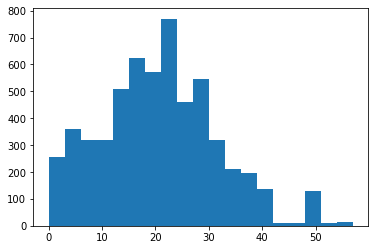

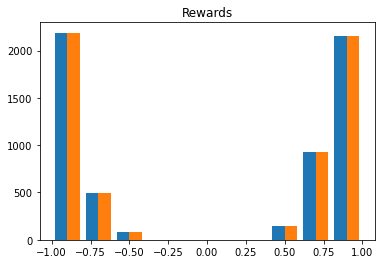

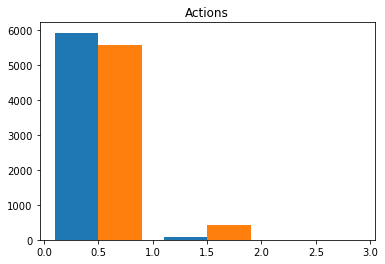

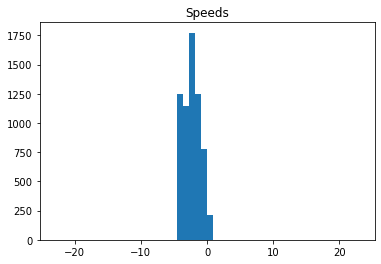

5647 353 0
Performing trajectory rollouts: 50
[Parameter containing:
tensor([[ 2.1112e-01,  1.0603e-01,  1.7321e-01,  6.8158e-02,  1.9384e-01,
          1.7913e-01,  3.3288e-01,  3.3281e-02,  4.1942e-02,  2.3530e-01,
         -7.9655e-03],
        [-9.3215e-02, -2.0831e-01,  1.2617e-01,  1.8679e-01, -1.8721e-01,
         -2.0566e-01,  1.5512e-01,  3.2328e-01,  2.9943e-01,  2.9876e-01,
         -2.0499e-01],
        [ 1.5186e-01, -2.1823e-01,  1.1533e-01,  1.8765e-01, -1.2009e-01,
         -1.3594e-01,  2.9529e-01, -5.1842e-02, -2.3066e-01,  2.2163e-02,
         -6.7221e-02],
        [ 2.8067e-01,  1.1458e-01, -1.2361e-01,  2.1809e-01, -1.2266e-01,
          1.8489e-01,  3.1152e-02, -1.8800e-01, -6.5642e-02, -1.8589e-01,
         -2.3141e-01],
        [ 1.7851e-01, -2.1097e-01, -9.3720e-02, -2.6085e-02,  5.5716e-02,
         -2.2585e-01, -1.5348e-01, -4.8848e-02, -1.9095e-02,  2.3280e-01,
          2.5393e-01],
        [ 1.1235e-01,  2.4553e-01,  6.0636e-02, -1.5399e-01,  5.7318e-02,
  

tensor([[-0.9879, -0.9879],
        [ 0.9981,  0.9981],
        [-0.9730, -0.9730],
        ...,
        [ 0.7636,  0.7636],
        [ 0.7815,  0.7815],
        [-0.7815, -0.7815]])
Updating gradient...
epoch = 3 dist = (93.75766213948907, 109.8349832406411, 100.44499033781199), best_dist = (88.59493613334797, 108.20326997866995, 100.79091950792531) 


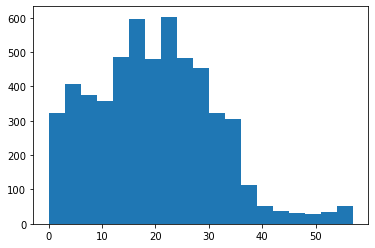

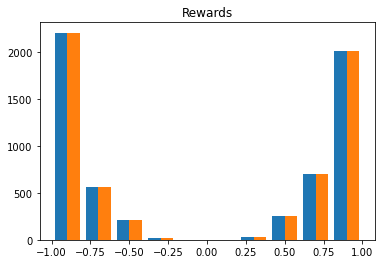

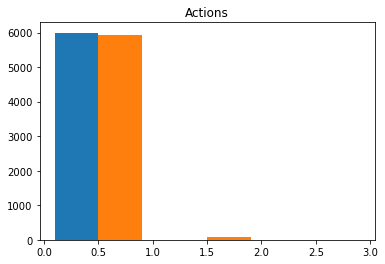

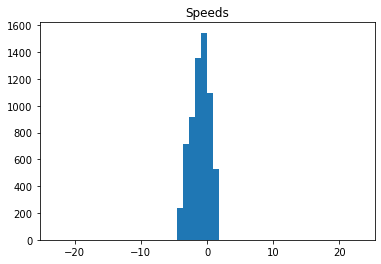

5935 65 0


In [39]:
# train the fine tuned planner
from state_agent.utils_agent import euler_to_quaternion


def create_planner_actor():
    return PlayerPuckGoalFineTunedPlannerActor(mode=PlayerPuckGoalFineTunedPlannerActorNetwork.MODE_SPEED)
        

def gen_agent(*args, **kwargs):
    return Agent(target_speed=20, *args, **kwargs)

def post_epoch(actor, context):
    # show a histogram of distances
    show_trajectory_histogram(context.trajectories, get_distance_cart_to_puck, max=60, bins=20)
    plt.hist(context.rewards) 
    plt.title("Rewards")
    plt.show()
    plt.hist(context.actions, 3, range=(0, 3)) 
    plt.title("Actions")
    plt.show()
    
    # extract speed offsets
    plt.hist(np.array(context.outputs)[:,PlayerPuckGoalFineTunedPlannerActor.OUT_FEATURE_SPEED_OFFSET], 50, range=(-23, 23)) 
    plt.title("Speeds")
    plt.show()
    print(np.sum(np.argmax(context.actions, axis=1) == 0), np.sum(np.argmax(context.actions, axis=1) == 1), np.sum(np.argmax(context.actions, axis=1) == 2))

def rollout_initializer(world_info, randomize, **kwargs):
        
    wall_case = np.random.uniform(low=0.0, high=1.0) < 0.25
    #wall_case = True
    
    behind_case = np.random.uniform(low=0.0, high=1.0) < 0.25
    behind_case = False
    
    # generate a rollout where the player and puck are near each other
    position = [
        np.random.uniform(low=-35, high=35),
        np.random.uniform(low=-50, high=62), # trying to force the puck to a 90 degree angle at worst (near the wall)
    ]
    
    offset = [np.random.uniform(low=-1.0, high=1.0), -6]    
    
    position = [
            np.random.uniform(low=-35, high=35),
            np.random.uniform(low=-20, high=20)
        ]
    # put the cart facing away from the puck
    offset = [np.random.uniform(low=-1.0, high=1.0), np.random.uniform(low=1.0, high=15.0)]        
        
    orientation = euler_to_quaternion((0, 0, 0))
        
    player_location = [position[0] + offset[0], 1, position[1] + offset[1]]
        
    if behind_case:
        
        angle = np.random.uniform(low=0.35, high=1.0) * np.sign(np.random.uniform(0, 1))
        
        # point the cart away from the puck
        orientation = euler_to_quaternion((0, angle, 0))
        
    elif wall_case:
        angle = np.random.uniform(0, 2 * np.pi)
        
        # determine x and y based on length        
        y = np.cos(angle) * 50
        x = np.sin(angle) * 50
        player_location = [x, 1, y]                
        orientation = euler_to_quaternion((0, angle, 0))
        #player_location = None
        #position = [45 * side, -40]
            
    world_info.set_ball_location((position[0], 1, position[1]), (0, 0, 0))        
    if player_location is not None:
        world_info.set_kart_location(0, player_location, orientation, 0)
    
#good_initialization_planner, _ = get_initializations(create_planner_actor)

#actor_net = copy.deepcopy(good_initialization_planner.actor_net)
actor_net = best_planner_ft_net
actors = [
    PlayerPuckGoalPlannerActor(best_planner_net, train=False),
    PlayerPuckGoalFineTunedPlannerActor(actor_net, mode=PlayerPuckGoalFineTunedPlannerActorNetwork.MODE_BOTH),
    DriftActor(best_drift_net, train=False),
    SpeedActor(best_speed_net, train=False),
    SteeringActor(best_steering_net, train=False)
]

# give it a positive random weight to make it the worst case
#action_net.net[0].weight = torch.nn.Parameter(torch.Tensor([[np.random.uniform(0, 1.0)]]))

#starting_weight = action_net.net[0].weight.clone()
#print("Starting weight", action_net.net[0].weight)

# configuration
config = SoccerReinforcementConfiguration()
config.agent = gen_agent
config.rollout_initializer = rollout_initializer

# iterations is high relatively here to help force a good outcome from a bad initialization
best_planner_ft_net = reinforce(actors[1], actors, config, 
                              n_epochs=4, n_iterations=50, n_trajectories=50, n_validations=20, T=[2, 4, 8],
                              epoch_post_process=post_epoch
                    )


In [22]:
extractor=SoccerFeatures(None, [0, 0, 0])
f = torch.Tensor([0.0 for i in range(9 * 40)]).view(-1, 40)
good_initialization_planner(None, f, extractor)

RuntimeError: mat1 and mat2 shapes cannot be multiplied (9x40 and 9x40)

In [43]:
# Save the Planner Actor
PlayerPuckGoalFineTunedPlannerActor(best_planner_ft_net).save_model()

PlayerPuckGoalFineTunedPlannerActorNetwork(
  (action_net): LinearNetwork(
    (base): BaseNetwork(
      (net): Sequential(
        (0): Linear(in_features=11, out_features=40, bias=True)
        (1): Tanh()
        (2): Linear(in_features=40, out_features=2, bias=True)
      )
    )
  )
)

In [ ]:
# Load the Planner Actor 
best_planner_ft_net = PlayerPuckGoalFineTunedPlannerActor().load_model()

IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (400, 300) to (400, 304) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


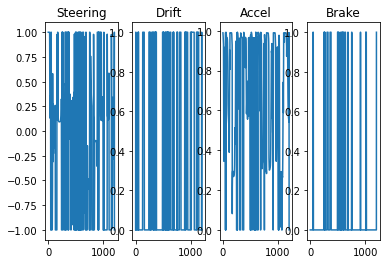

In [44]:
viz_rollout_soccer = { "screen_width": 400, "screen_height": 300, "mode": "soccer", "players":[(0, False, "konqi")], "num_karts":2 }
data = run_soccer_agent(Agent(     
    PlayerPuckGoalPlannerActor(
        best_planner_net
    ),
    PlayerPuckGoalFineTunedPlannerActor(                
        best_planner_ft_net,
        mode=PlayerPuckGoalFineTunedPlannerActorNetwork.MODE_BOTH
    ), 
    SteeringActor(best_steering_net),
    DriftActor(best_drift_net),
    SpeedActor(best_speed_net),
    target_speed=20.0,
), randomize=True, n_steps=1200, rollout=viz_rollout_soccer)

In [ ]:
def bce_loop(optim, net):
    loss_bce = torch.nn.BCEWithLogitsLoss()
    net.train()
    optim.zero_grad()
    idx = torch.randperm(batch_features.shape[0])
    t_shuffled = batch_features[idx]
    batch_actions, batch_rewards, batch_labels = reward(t_shuffled)
    output = (net(t_shuffled)).squeeze() # + 1) / 2
    #print(output)
    #log_p = log_prob(output, actions=batch_actions)
    #expected_log_return = (log_p.squeeze()*batch_returns).mean()
    loss = loss_bce(output, batch_labels)    
    #(-expected_log_return).backward()
    loss.backward()

    #print("Grad", net.net[0].weight.grad)

    optim.step()
    net.eval()
    return batch_actions

def nll_loop(optim, net, static_reward=True):
    net.train()
    optim.zero_grad()
    idx = torch.randperm(batch_features.shape[0])
    t_shuffled = batch_features[idx]
    batch_actions, batch_rewards, batch_labels = reward(t_shuffled)
    output = (net(t_shuffled)).squeeze() # + 1) / 2
    #print(output)    
    if static_reward:
        log_p = log_prob(output, actions=batch_labels)
        expected_log_return = (log_p.squeeze()*1).mean()
    else:
        log_p = log_prob(output, actions=batch_actions)
        expected_log_return = (log_p.squeeze()*batch_rewards).mean()
    (-expected_log_return).backward()
    #loss.backward()

    #print("Grad", net.net[0].weight.grad)

    optim.step()
    net.eval()
    return batch_actions

    
net=LinearWithSigmoid(n_inputs=2, n_hidden=10, n_outputs=1, bias=True)
optim = torch.optim.Adam(net.parameters(), lr=1e-3)
print("bce (before)", ((net(batch_features) > 0.5).squeeze() == correct_labels).sum())
data = [bce_loop(optim, net) for i in range(10000)]
print("bce", ((net(batch_features) > 0.9).squeeze() == correct_labels).sum())

net=LinearWithSigmoid(n_inputs=2, n_hidden=10, n_outputs=1, bias=True)
optim = torch.optim.Adam(net.parameters(), lr=1e-3)
print("nll (before)", ((net(batch_features) > 0.5).squeeze() == correct_labels).sum())
data = [nll_loop(optim, net, static_reward=True) for i in range(10000)]
print("nll", ((net(batch_features) > 0.9).squeeze() == correct_labels).sum())

net=LinearWithSigmoid(n_inputs=2, n_hidden=10, n_outputs=1, bias=True)
optim = torch.optim.Adam(net.parameters(), lr=1e-3)
print("nll with rewards (before)", ((net(batch_features) > 0.5).squeeze() == correct_labels).sum())
data = [nll_loop(optim, net, static_reward=False) for i in range(10000)]
print("nll with rewards", ((net(batch_features) > 0.9).squeeze() == correct_labels).sum())

In [ ]:
np.mean([[12.0, 102], [20, 39]], axis=0)

In [45]:
# create a composed agent
agent = ComposedAgent()
agent.agent_net.speed_actor = best_speed_net
agent.agent_net.steering_actor = best_steering_net
agent.agent_net.drift_actor = best_drift_net
agent.agent_net.planner_actor = best_planner_net
agent.agent_net.ft_planner_actor = best_planner_ft_net 
display(agent.agent_net.state_dict())
agent.save_models("agent_net")
composed_agent=agent

OrderedDict([('steering_actor.action_net.linear.base.net.0.weight',
              tensor([[ 2.3779],
                      [ 2.2968],
                      [-2.3703],
                      [-2.4959],
                      [-2.2973],
                      [ 1.5942],
                      [ 1.8785],
                      [-1.7396],
                      [ 2.4222],
                      [ 2.3028],
                      [-2.2796],
                      [-1.9101],
                      [ 2.3975],
                      [ 1.9419],
                      [-2.1092],
                      [ 1.7201],
                      [ 1.9340],
                      [-1.3093],
                      [ 1.9515],
                      [ 1.9362]])),
             ('steering_actor.action_net.linear.base.net.2.weight',
              tensor([[ 1.5269,  1.5692, -1.4678, -1.5982, -1.5322,  1.7165,  1.5785, -1.5630,
                        1.3673,  1.4887, -1.4482, -1.6752,  1.4838,  1.5838, -1.5201,  1.2141,
           

In [ ]:
composed_network = ComposedAgentNetwork(
    SteeringActor().action_net,  # type: ignore
    SpeedActor().actor_net,     # type: ignore
    DriftActor().actor_net,      # type: ignore
    PlayerPuckGoalPlannerActor().actor_net,
    PlayerPuckGoalFineTunedPlannerActor().actor_net
)

#composed_agent = ComposedAgent(composed_network, target_speed=10.0)
#composed_agent.load_models("agent1_net", use_jit=True)




# create a composed agent
agent = ComposedAgent()
agent.agent_net.steering_actor = composed_agent.agent_net.steering_actor
agent.agent_net.speed_actor = composed_agent.agent_net.speed_actor
agent.agent_net.drift_actor = composed_agent.agent_net.drift_actor
agent.agent_net.planner_actor = composed_agent.agent_net.planner_actor
agent.agent_net.ft_planner_actor = composed_agent.agent_net.ft_planner_actor
agent.save_models("agent_net")

In [46]:
# load a composed agent
composed_agent = ComposedAgent(
    target_speed=20.0
)

composed_agent.load_models("agent_net", use_jit=True)
display(composed_agent.agent_net)
print(composed_agent.actors_to_execute)

RecursiveScriptModule(
  original_name=ComposedAgentNetwork
  (steering_actor): RecursiveScriptModule(
    original_name=SteeringActorNetwork
    (action_net): RecursiveScriptModule(
      original_name=LinearWithTanh
      (linear): RecursiveScriptModule(
        original_name=LinearNetwork
        (base): RecursiveScriptModule(
          original_name=BaseNetwork
          (net): RecursiveScriptModule(
            original_name=Sequential
            (0): RecursiveScriptModule(original_name=Linear)
            (1): RecursiveScriptModule(original_name=Tanh)
            (2): RecursiveScriptModule(original_name=Linear)
            (3): RecursiveScriptModule(original_name=Tanh)
          )
        )
      )
    )
  )
  (speed_actor): RecursiveScriptModule(
    original_name=SpeedActorNetwork
    (action_net): RecursiveScriptModule(
      original_name=LinearWithTanh
      (linear): RecursiveScriptModule(
        original_name=LinearNetwork
        (base): RecursiveScriptModule(
         

[True, True, True, True, True]


IMAGEIO FFMPEG_WRITER WARNING: input image is not divisible by macro_block_size=16, resizing from (400, 300) to (400, 304) to ensure video compatibility with most codecs and players. To prevent resizing, make your input image divisible by the macro_block_size or set the macro_block_size to 1 (risking incompatibility).


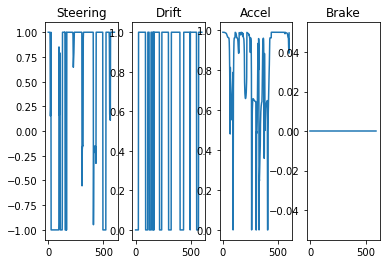

In [22]:
# test composed agent in a rollout
viz_rollout_soccer = { "screen_width": 400, "screen_height": 300, "mode": "soccer", "players":[(0, False, "tux")], "num_karts":2 }
data = run_soccer_agent(composed_agent, randomize=True, rollout=viz_rollout_soccer)